In [1]:
!pip install evaluate
!pip install -U datasets

In [ ]:
# Invalid pattern: '**' can only be an entire path component
!pip install -U datasets huggingface_hub fsspec


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 514.8/514.8 kB 11.2 MB/s eta 0:00:00
  Attempting uninstall: huggingface_hub
    Found existing installation: huggingface-hub 0.32.4
    Uninstalling huggingface-hub-0.32.4:
      Successfully uninstalled huggingface-hub-0.32.4


In [ ]:
!pip install --upgrade transformers

## Benchmark Tools
Below are the helper functions needed to run the benchmarks. It is necessary to run this every time the kernal starts / restarts.


In [2]:
from transformers import pipeline
import evaluate

# split inputs according to prep_data output
def split_inputs(inputs):
    print("Image list: {}".format(inputs[0]))
    print("Question list: {}".format(inputs[1]))
    print("Reference list: {}".format(inputs[2]))

    return inputs[0], inputs[1], inputs[2]

# split prompts into system and user prompts
def split_prompts(sys_user_prompts):
    return sys_user_prompts[0], sys_user_prompts[1]

# runs get_predictions and eval_results; returns predictions and evaluations
def run_benchmark(models, inputs, sys_user_prompts, metric_type):
    num_of_models = len(models)
    predictions = {}
    model_results = {}

    sys_prompt, user_prompt = split_prompts(sys_user_prompts)
    img_list, qn_list, ref_list = split_inputs(inputs)

    for i in range(num_of_models):
        model = models[i]
        prediction_list = get_predictions(model=model, img_list=img_list, qn_list=qn_list,
                                          sys_prompt=sys_prompt, global_user_prompt=user_prompt)
        predictions[model] = prediction_list

        print("prediction_list ({}): {}".format(model, prediction_list))

        evaluation = eval_results(img_list=img_list, qn_list=qn_list, ref_list=ref_list,
                                  pred_list=prediction_list, metric_type=metric_type)
        model_results[model] = evaluation
        print("evaluation ({}): {}".format(model, evaluation))

    return predictions, model_results



# returns output_list
def get_predictions(model, img_list, qn_list, sys_prompt, global_user_prompt=None):
    print("Obtaining predictions from {}".format(model))
    pipe = pipeline("image-text-to-text", model=model,)
    pipe.model.config.pad_token_id = pipe.tokenizer.eos_token_id
    data_size = len(img_list)
    prediction_list = [None for _ in range(data_size)]

    for i in range(data_size):
        img = img_list[i]
        # take prompt from qn_list is there is no global user_prompt
        if global_user_prompt is None:
            user_prompt = qn_list[i]
        else:
            user_prompt = global_user_prompt

        messages = [
            {"role": "system",
            "content": [{"type": "text", "text": sys_prompt}]},
            {"role": "user",
            "content": [{"type": "image"}, {"type": "text", "text": user_prompt}]},
        ]

        output = pipe(images=img,
                    text=messages,
                    generate_kwargs={"max_new_tokens": 10},
                    return_full_text=False)

        prediction = output[0]['generated_text']

        # REMOVE punctuation coz models dont follow instructions
        # Remove trailing / leading spaces
        prediction = prediction.replace(".","").strip()

        prediction_list[i] = prediction

    return prediction_list

# returns evaluation result
def eval_results(img_list, qn_list, ref_list, pred_list, metric_type, breakdown=False):
    print("Evaluating predictions")
    eval_metric = evaluate.load(metric_type)
    data_size = len(img_list)
    if breakdown is True:
        print("Results of the benchmark:")

        for i in range(data_size):
            img_list[i].show() # for local machine
            # display(img_list[i]) # for Google Colab
            print("Question: {}".format(qn_list[i]))
            print("Predicted: {}".format(pred_list[i]))
            print("Actual: {}".format(ref_list[i]))

    results = eval_metric.compute(references=ref_list, predictions=pred_list)
    return_result = round(results[metric_type], 2)
    return return_result

# two-pass, returns both the scores as well as reasoning
def judge_captions(model, img_list, ref_list, cand_list, data_size):

    data_size = len(img_list)

    judge_prompt = "Your task is to evaluate and rate the candidate caption on a scale of 0.0 to 1.0 based on the given Grading Criteria. " \
        "(Print ONLY a decimal number between 0.0 and 1.0) " \
        "Grading Scale:" \
        "0.0: The caption does not describe the image at all." \
        "0.5: The caption is partially correct but has notable inaccuracies." \
        "1.0: The caption accurately and clearly describes the image." \
        "Examples: - Perfect match: 1.0 - One minor detail wrong: 0.8 - Missing half the content: 0.5 - Completely wrong: 0.0\n" \
        "Reference Captions: {ref}" \
        "Candidate Caption: {cand}" \
        "Score (Print ONLY the decimal number): "

    judge_followup_prompt = "Why? Tell me the reason."

    pipe = pipeline("image-text-to-text", model=model)
    score_list = [None for _ in range(data_size)]
    reason_list = [None for _ in range(data_size)]

    for i in range(data_size):
        input_prompt = judge_prompt.format(ref=ref_list[i], cand=cand_list[i])

        msg = [
            {"role": "user",
            "content": [{"type": "image"},
                        {"type": "text", "text": input_prompt}]
            },
        ]

        output = pipe(images=img_list[i],
                text=msg,
                generate_kwargs={"max_new_tokens": 10},
                return_full_text=False)

        score = output[0]['generated_text']
        score_list[i] = score

        followup_msg = [
                {"role": "user",
                "content": [{"type": "image"},
                            {"type": "text", "text": input_prompt}]
                },
                {"role": "assistant",
                "content": [{"type": "text", "text": score + "/ 1.0"}]},
                {"role": "user",
                "content": [{"type": "text", "text": judge_followup_prompt}]},
            ]

        reason_output = pipe(images=img_list[i],
                            text=followup_msg,
                            generate_kwargs={"max_new_tokens": 50},
                            return_full_text=False)

        judge_reason = reason_output[0]['generated_text']
        reason_list[i] = judge_reason

    return score_list, reason_list

# for Colab
def show_individual(inputs, predictions):
    img_list, qn_list, ref_list = split_inputs(inputs)
    if len(qn_list) == 0: # only global questions, no individual
        qn_list = ["" for _ in img_list]

    for i in range(len(img_list)):
        display(img_list[i])
        print("Question: {}".format(qn_list[i]))
        print("Truth: {}".format(ref_list[i]))
        for key, val in predictions.items():
            print("Predicted ({}): {}".format(key, val[i]))

def show_results(inputs, evaluations):
    _, _, ref_list = split_inputs(inputs)
    print("Benchmark Results:")
    print("Truth: {}".format(ref_list))
    for key, val in evaluations.items():
        print("{}: {}".format(key, val))

## Models
Below are the models available to use for the benchmark, comment out any models that are not necessary for the run


In [3]:
models = [
            # "google/gemma-3-12b-it",
            # "llava-hf/llava-onevision-qwen2-7b-ov-hf",
            # "Qwen/Qwen2.5-VL-7B-Instruct",
            # "mistralai/Mistral-7B-v0.3",
            # "google/gemma-3-4b-it",
            # "Qwen/Qwen2.5-VL-3B-Instruct",
            "Qwen/Qwen2-VL-2B-Instruct",
            "llava-hf/llava-onevision-qwen2-0.5b-ov-hf",
            "HuggingFaceTB/SmolVLM-256M-Instruct",
          ]

def get_models():
    return models

## Benchmarks
Below are the benchmarking tasks

## Object Counting
The dataset is based on TallyQA


Preparing data with size: 10
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC19CC3F90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x357 at 0x78AC1139AED0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11A74510>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x464 at 0x78AC119AC1D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x281 at 0x78AC1138F010>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x316 at 0x78AC11AE4D10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE5950>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=381x640 at 0x78AC11AE6090>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11AA7110>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC1118A150>]
Question list: ['How many people are crossing the street?\nGive a very brief answer.', 'How many hot dogs are there?\nGive a ver

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['2', '1', '100', '2', '1', '3', '0', '2', '10', '2']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.8
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['1', '1', '100', '2', '1', '3', '0', '3', '10', '2']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.6
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['2', '1', '2', '2', '1', '3', '0', '2', '2', '1']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.8
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC19CC3F90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x357 at 0x78AC1139AED0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11A74510>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x464 at 0x78AC119AC1D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x281 at 0x78AC1138F010>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x316 at 0x78AC11AE4D10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE5950>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=381x640 at 0x78AC11AE6090>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11AA7110>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=50

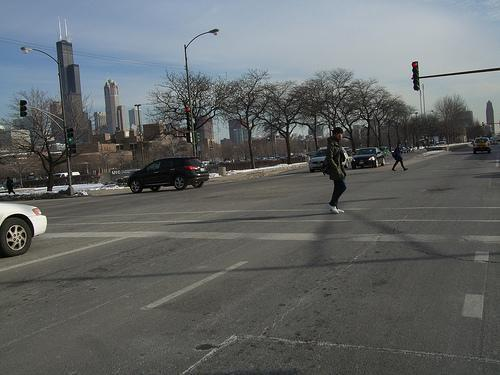

Question: How many people are crossing the street?
Give a very brief answer.
Truth: 2
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2


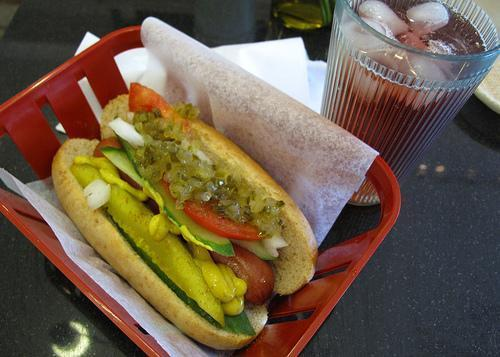

Question: How many hot dogs are there?
Give a very brief answer.
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


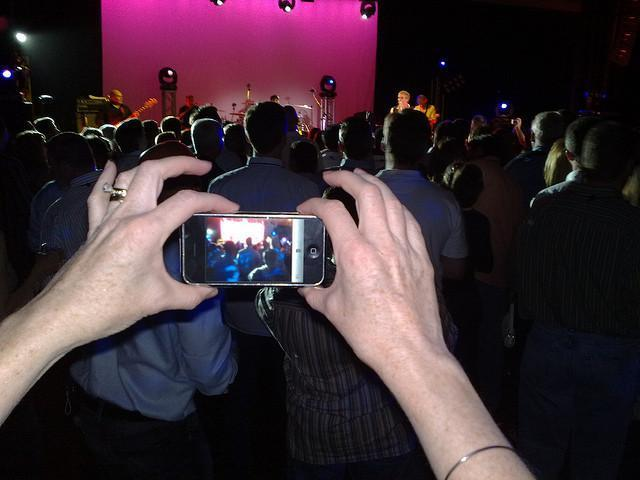

Question: How many people are there?
Give a very brief answer.
Truth: 8
Predicted (Qwen/Qwen2-VL-2B-Instruct): 100
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 100
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2


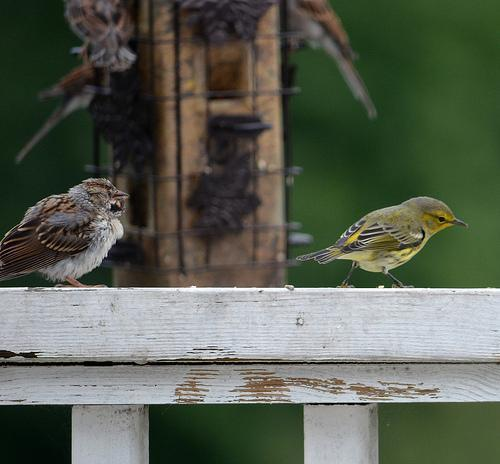

Question: How many birds on fence?
Give a very brief answer.
Truth: 2
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 2
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2


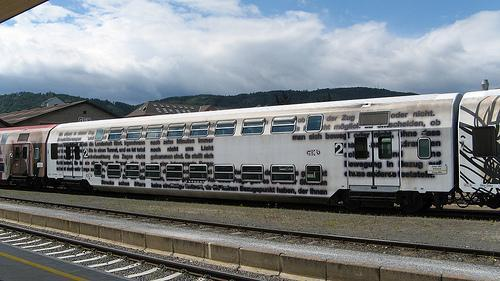

Question: How many trains are there?
Give a very brief answer.
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


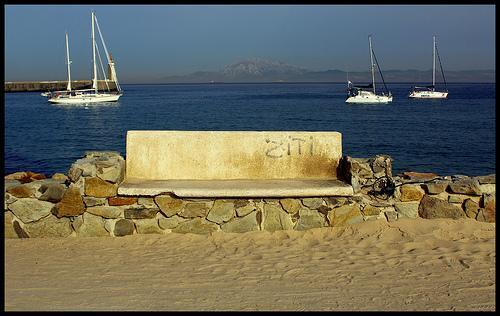

Question: How many boats are there?
Give a very brief answer.
Truth: 3
Predicted (Qwen/Qwen2-VL-2B-Instruct): 3
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 3
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 3


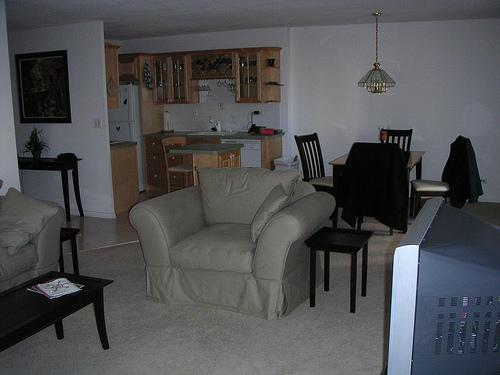

Question: How many white coats are there?
Give a very brief answer.
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 0
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 0


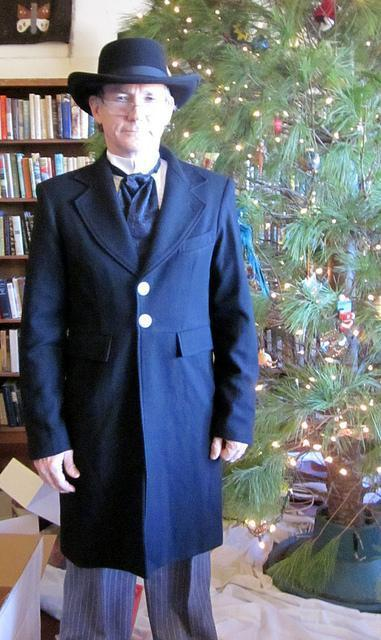

Question: How many buttons are on the man's coat?
Give a very brief answer.
Truth: 2
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 3
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2


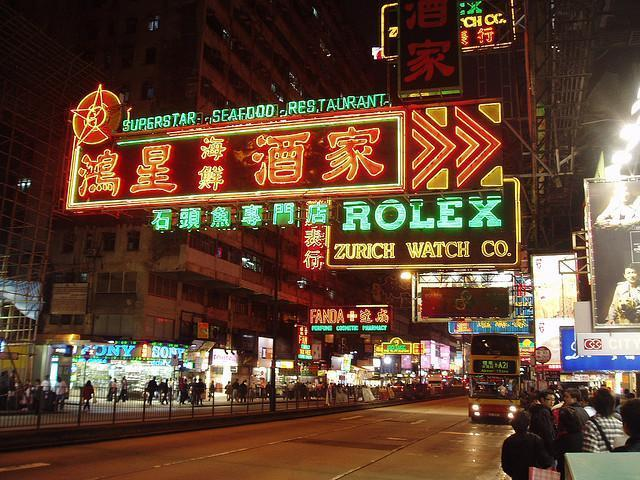

Question: How many people are there?
Give a very brief answer.
Truth: 2
Predicted (Qwen/Qwen2-VL-2B-Instruct): 10
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 10
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2


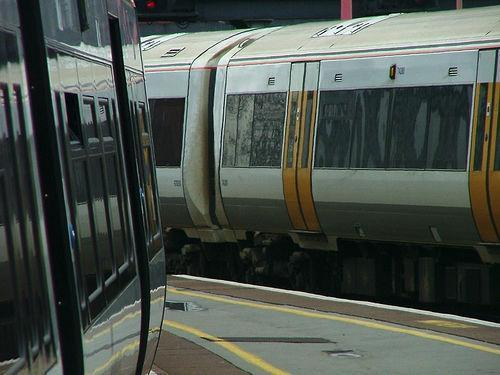

Question: How many subway trains are in the photo?
Give a very brief answer.
Truth: 2
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 2
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC19CC3F90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x357 at 0x78AC1139AED0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11A74510>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x464 at 0x78AC119AC1D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x281 at 0x78AC1138F010>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x316 at 0x78AC11AE4D10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE5950>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=381x640 at 0x78AC11AE6090>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11AA7110>, <PIL.

In [21]:
from datasets import load_dataset
from PIL import Image
import io

#----- hyperparameters -----

dataset_path = "nimapourjafar/mm_tallyqa"
dataset_split = "train"
sample_size = 10

system_prompt = "You are an object counting tool. Your task is to estimate the number of objects in the provided image. "\
"Analyze the image and respond ONLY with a single number. Do not provide any explanation or introductory text or punctuation."
global_user_prompt = None
metric_type = "exact_match"

#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    print("Preparing data with size: {}".format(split_size))
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['images']
    image_list = [img[0]['bytes'] for img in image_list]
    image_list = [Image.open(io.BytesIO(b)) for b in image_list]

    data_list = input_dataset['data']
    question_data_list = [x[1] for x in data_list] # get data of first question
    question_data_list = [q['data'] for q in question_data_list] # get first question as string
    answer_data_list = [x[2] for x in data_list] # get data of answer
    answer_data_list = [q['data'] for q in answer_data_list] # get answer as string
    answer_data_list = [s[:-1] for s in answer_data_list] # remove the '.' at the end of the answers

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT


inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

show_individual(inputs, predictions)
show_results(inputs, evaluations)



In [23]:
from datasets import load_dataset
from PIL import Image
import io

#----- hyperparameters -----

dataset_path = "nimapourjafar/mm_tallyqa"
dataset_split = "train"
sample_size = 50

system_prompt = "You are an object counting tool. Your task is to estimate the number of objects in the provided image. "\
"Analyze the image and respond ONLY with a single number. Do not provide any explanation or introductory text or punctuation."
global_user_prompt = None
metric_type = "exact_match"

#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    print("Preparing data with size: {}".format(split_size))
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['images']
    image_list = [img[0]['bytes'] for img in image_list]
    image_list = [Image.open(io.BytesIO(b)) for b in image_list]

    data_list = input_dataset['data']
    question_data_list = [x[1] for x in data_list] # get data of first question
    question_data_list = [q['data'] for q in question_data_list] # get first question as string
    answer_data_list = [x[2] for x in data_list] # get data of answer
    answer_data_list = [q['data'] for q in answer_data_list] # get answer as string
    answer_data_list = [s[:-1] for s in answer_data_list] # remove the '.' at the end of the answers

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT


inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

# show_individual(inputs, predictions)
show_results(inputs, evaluations)


Preparing data with size: 50
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC251429D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC25143E10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x398 at 0x78ABFD204310>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE6650>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11AE5A10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x333 at 0x78AC11AE4D10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=375x500 at 0x78AC11AE6D90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE5ED0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x293 at 0x78ABFD239890>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC25142A90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x333 at 0x78AC25117D90>, <PIL.JpegImagePlugin.JpegImageFile image mode

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['0', '3', '3', '0', '2', '1', '1', '2', '2', '1', '3', '4', '4', '1', '3', '1', '1', '0', '1', '2', '2', '0', '0', '0', '2', '0', '12', '3', '6', '1', '3', '4', '0', '2', '2', '2', '2', '2', '15', '1', '2', '1', '1', '1', '1', '11', '4', '1', '2', '1']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.72
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to 

prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['0', '3', '3', '0', '2', '1', '1', '2', '1', '1', '2', '3', '4', '1', '3', '1', '1', '0', '1', '2', '2', '0', '0', '1', '10', '0', '2', '2', '10', '1', '3', '4', '0', '2', '2', '2', '2', '2', '10', '1', '2', '2', '2', '1', '1', '10', '4', '2', '2', '1']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.68
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['0', '3', '2', '0', '2', '1', '1', '2', '0', '1', '2', '2', '4', '1', '3', '1', '1', '0', '1', '2', '2', '0', '0', '0', '11', '0', '12', '2', '0', '1', '2', '2', '0', '2', '2', '2', '2', '3', '7', '1', '2', '2', '1', '1', '1', '7', '4', '1', '2', '1']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.82
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC251429D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC25143E10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x398 at 0x78ABFD204310>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC11AE6650>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x480 at 0x78AC11AE5A10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x333 at 0x78AC11AE4D10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=375x500 at 0x78AC11AE6D90>, <PIL.JpegImagePlugin

In [25]:
from datasets import load_dataset
from PIL import Image
import io

#----- hyperparameters -----

dataset_path = "nimapourjafar/mm_tallyqa"
dataset_split = "train"
sample_size = 100

system_prompt = "You are an object counting tool. Your task is to estimate the number of objects in the provided image. "\
"Analyze the image and respond ONLY with a single number. Do not provide any explanation or introductory text or punctuation."
global_user_prompt = None
metric_type = "exact_match"

#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    print("Preparing data with size: {}".format(split_size))
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['images']
    image_list = [img[0]['bytes'] for img in image_list]
    image_list = [Image.open(io.BytesIO(b)) for b in image_list]

    data_list = input_dataset['data']
    question_data_list = [x[1] for x in data_list] # get data of first question
    question_data_list = [q['data'] for q in question_data_list] # get first question as string
    answer_data_list = [x[2] for x in data_list] # get data of answer
    answer_data_list = [q['data'] for q in answer_data_list] # get answer as string
    answer_data_list = [s[:-1] for s in answer_data_list] # remove the '.' at the end of the answers

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT


inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

# show_individual(inputs, predictions)
show_results(inputs, evaluations)


Preparing data with size: 100
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC11189510>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x333 at 0x78AC119D7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=375x500 at 0x78AC1118B410>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC113B8810>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x375 at 0x78AC1103DC90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x424 at 0x78AC11399C10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=426x640 at 0x78AC1139AF50>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x427 at 0x78AC111B6550>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x424 at 0x78AC25180050>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=500x281 at 0x78AC1103D650>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=427x640 at 0x78AC11AA7350>, <PIL.JpegImagePlugin.JpegImageFile image mod

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['2', '2', '1', '3', '1', '2', '2', '2', '1', '8', '0', '2', '1', '2', '1', '0', '0', '0', '1', '6', '2', '3', '1', '3', '1', '4', '2', '2', '1', '1', '0', '0', '1', '2', '1', '0', '1', '2', '3', '1', '0', '1', '2', '2', '2', '1', '1', '2', '0', '0', '1', '0', '0', '2', '7', '16', '3', '2', '10', '4', '3', '1', '2', '1', '1', '3', '1', '0', '4', '2', '2', '0', '1', '1', '1', '2', '1', '3', '0', '4', '10', '2', '2', '5', '0', '4', '1', '0', '2', '2', '4', '5', '1', '1', '1', '10', '2', '1', '2', '1']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.74
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to 

prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['100', '2', '1', '3', '2', '3', '2', '2', '1', '12', '1', '2', '1', '2', '1', '0', '0', '0', '1', '7', '2', '3', '1', '2', '1', '4', '2', '2', '1', '2', '0', '0', '1', '0', '1', '0', '1', '2', '3', '1', '0', '1', '3', '2', '2', '1', '1', '2', '0', '0', '2', '0', '0', '2', '10', '16', '3', '1', '100', '4', '2', '1', '10', '1', '2', '4', '1', '0', '4', '4', '2', '0', '1', '2', '1', '2', '1', '4', '0', '5', '10', '2', '2', '5', '0', '4', '1', '0', '2', '2', '3', '10', '1', '1', '1', '10', '2', '1', '2', '1']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.7
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['3', '2', '1', '3', '2', '2', '2', '3', '1', '4', '0', '2', '1', '2', '1', '0', '0', '0', '1', '5', '2', '3', '1', '2', '1', '4', '3', '2', '1', '1', '0', '0', '0', '2', '2', '0', '1', '2', '3', '1', '0', '1', '4', '3', '2', '1', '1', '1', '0', '0', '2', '0', '0', '2', '5', '16', '2', '2', '10', '4', '2', '1', '2', '1', '1', '3', '1', '0', '4', '2', '2', '0', '1', '1', '1', '1', '1', '2', '0', '4', '3', '2', '2', '5', '0', '4', '1', '0', '2', '2', '3', '10', '1', '1', '1', '5', '1', '1', '1', '1']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.79


TypeError: show_results() takes 2 positional arguments but 3 were given

## Optical Character Recognition
The follow dataset is based on TextOCR


Image list: [<PIL.PngImagePlugin.PngImageFile image mode=RGB size=67x52 at 0x78AC1AAF5990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=169x58 at 0x78AC1AAF4990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=174x37 at 0x78AC1AAF4610>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=142x32 at 0x78AC1AAF6210>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=70x37 at 0x78AC1AAF4190>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=132x47 at 0x78AC1AAF5D10>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=71x38 at 0x78AC1AAF55D0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=471x97 at 0x78AC1AAF5910>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=279x97 at 0x78AC1AAF6050>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=79x56 at 0x78AC1AAF53D0>]
Question list: []
Reference list: ['RED', 'VEGAS', 'EQUALITY', 'DOMORI', 'But', 'naturally', '2007', 'ASTRONAUT', 'Camera', '2004']
Obtaining predictions from Qwen/Qwen2-VL-2B-Instruct


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['red', 'vegas', 'equality', 'DOMORI', 'but', 'Natureally', '2007', 'astronaut', 'camera', '2004']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.3
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['RED', 'VEGAS', 'EQUITY', 'DOMORI', 'Butt', 'The image is too blurry to make out any text', '2007', 'Astronaut', 'Camera', '2004']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.6
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['REED', 'VEGAS', 'The image is a poster with the text "THE', 'Donor', 'But', 'The text is "Chronologically"', '2007', 'astronaut', 'Camera', '2001']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.4
Image list: [<PIL.PngImagePlugin.PngImageFile image mode=RGB size=67x52 at 0x78AC1AAF5990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=169x58 at 0x78AC1AAF4990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=174x37 at 0x78AC1AAF4610>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=142x32 at 0x78AC1AAF6210>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=70x37 at 0x78AC1AAF4190>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=132x47 at 0x78AC1AAF5D10>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=71x38 at 0x78AC1AAF55D0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=471x97 at 0x78AC1AAF5910>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=279x97 at 0x78A

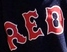

Question: 
Truth: RED
Predicted (Qwen/Qwen2-VL-2B-Instruct): red
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): RED
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): REED


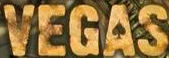

Question: 
Truth: VEGAS
Predicted (Qwen/Qwen2-VL-2B-Instruct): vegas
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): VEGAS
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): VEGAS


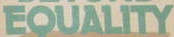

Question: 
Truth: EQUALITY
Predicted (Qwen/Qwen2-VL-2B-Instruct): equality
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): EQUITY
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): The image is a poster with the text "THE


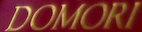

Question: 
Truth: DOMORI
Predicted (Qwen/Qwen2-VL-2B-Instruct): DOMORI
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): DOMORI
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): Donor


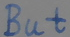

Question: 
Truth: But
Predicted (Qwen/Qwen2-VL-2B-Instruct): but
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): Butt
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): But


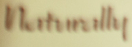

Question: 
Truth: naturally
Predicted (Qwen/Qwen2-VL-2B-Instruct): Natureally
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): The image is too blurry to make out any text
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): The text is "Chronologically"


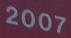

Question: 
Truth: 2007
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2007
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 2007
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2007


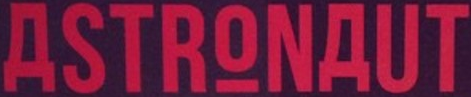

Question: 
Truth: ASTRONAUT
Predicted (Qwen/Qwen2-VL-2B-Instruct): astronaut
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): Astronaut
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): astronaut


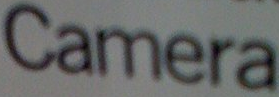

Question: 
Truth: Camera
Predicted (Qwen/Qwen2-VL-2B-Instruct): camera
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): Camera
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): Camera


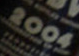

Question: 
Truth: 2004
Predicted (Qwen/Qwen2-VL-2B-Instruct): 2004
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 2004
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 2001
Image list: [<PIL.PngImagePlugin.PngImageFile image mode=RGB size=67x52 at 0x78AC1AAF5990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=169x58 at 0x78AC1AAF4990>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=174x37 at 0x78AC1AAF4610>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=142x32 at 0x78AC1AAF6210>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=70x37 at 0x78AC1AAF4190>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=132x47 at 0x78AC1AAF5D10>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=71x38 at 0x78AC1AAF55D0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=471x97 at 0x78AC1AAF5910>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=279x97 at 0x78AC1AAF6050>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=79x56 at 0x78AC1AAF53D0>]
Question l

In [18]:
from datasets import load_dataset

#----- hyperparameters -----
dataset_path = "MiXaiLL76/TextOCR_OCR"
dataset_split = "train"
sample_size = 10

system_prompt = "You are an optical character recognition (OCR) tool. Your ONLY function is to process an input image and output the text shown."\
"Do not provide any explanation or introductory text."
global_user_prompt = "Analyze the image and respond with ONLY the text shown. Give the shortest answer possible." # set to None if passing individual prompts
metric_type = "exact_match"
#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['image'] # get list of images
    question_data_list = [] # get list of questions (if necessary)
    answer_data_list = input_dataset['text'] # get list of answers

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT

inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

show_individual(inputs, predictions)
show_results(inputs, evaluations)



In [27]:
from datasets import load_dataset

#----- hyperparameters -----
dataset_path = "MiXaiLL76/TextOCR_OCR"
dataset_split = "train"
sample_size = 50

system_prompt = "You are an optical character recognition (OCR) tool. Your ONLY function is to process an input image and output the text shown."\
"Do not provide any explanation or introductory text."
global_user_prompt = "Analyze the image and respond with ONLY the text shown. Give the shortest answer possible." # set to None if passing individual prompts
metric_type = "exact_match"
#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['image'] # get list of images
    question_data_list = [] # get list of questions (if necessary)
    answer_data_list = input_dataset['text'] # get list of answers

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT

inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

# show_individual(inputs, predictions)
show_results(inputs, evaluations)



Image list: [<PIL.PngImagePlugin.PngImageFile image mode=RGB size=235x123 at 0x78AC25143390>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=153x85 at 0x78AC10FFC3D0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=88x37 at 0x78AC25142C90>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=162x92 at 0x78AC25143750>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=174x35 at 0x78AC251437D0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=201x50 at 0x78AC25143950>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=82x33 at 0x78AC186BDAD0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=135x91 at 0x78AC110C4290>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=116x95 at 0x78AC110C5190>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=97x49 at 0x78AC110C50D0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=102x49 at 0x78AC110C5A90>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=112x42 at 0x78AC10297850>, <PIL.PngImagePlugin.PngImageFil

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['girlfriend', 'create', 'million', 'Exhibition', 'tables', 'John Jamesonton', 'orwop', 'fuck', 'Diggers', 'WINE', '10th', 'people', 'Dragon', 'Rubber', 'Thrones', 'Hacienda', 'Kettle', 'strong', 'Moritz', 'stereoscopic', 'batala', 'Mike And', 'winter', 'Liquid', 'digital', 'impossible', 'hotel', 'FISH', 'Cheney Satan', 'g-1+', 'refermentée', 'cheesepreader', 'statutes', 'limited', 'centricity', 'Wicked', 'bach', 'I am a symbol of knowledge', 'record', 'you', 'Hjerte', 'Cordial', 'DO', "Someone's", '189', 'results', 'E!', 'Navarro', '12TH', 'ever']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.2
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to 

prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['girlfriend birth', 'create', 'Million', 'BITO', 'TABLES', 'John Lautner', 'o w o p o r', 'FUCK AUCINE', 'Diggers', 'PIERRE WINE', '10TH', 'people', 'Dragon', 'Rubber', 'THRONES', 'The image is too blurry to read the text', 'Kettle Brand', 'STRONG', 'MORITZ', 'Stereoscopic', 'BATAL', 'M=ke/Andy', 'WINTER', 'LIQUID', 'digital ital', 'IMPOSSIBLE', 'HOTEL', 'Fish', 'CHENE SANTAN', 'G-G-I+X', 'reformato', '10 Chees', 'statutes', 'LIMITED', 'centricity', 'WICKED A NEW MUSICAL', 'Bach', 'knowledge,', 'RECORD', 'You', 'Hjerte', 'CORDIAL', 'DO', 'SOMEONES', '189', 'The image is too blurry to make out any text', 'E!', 'NaVARRO', '12th', 'EVERY']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.4
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['Girl friend birthday', 'Create', 'Million', 'RECOVERY', 'TABLES', 'From fassusown', 'This is a piece of paper', 'FUCK AUXCE', 'DIGGERS', 'PLAYING WINE', '10TH', 'people', 'Dragon', 'Rubber', 'THRONES', 'The Hacienda', 'KETLEE BRAND', 'STRONG', 'Mortz', 'Stereoscopic', 'Matale', 'Mike (Andy)', 'WINTER', 'Liquid', 'Digital', 'IMPORTING', 'HOTEL', 'FISH', 'This is a blue and white sign', 'G-I+', "It's blurry", 'Spreader', 'Starts', 'LIMITED', 'Centricity', 'A new musical', '"Bach"', 'Knowledge', 'Rec', 'You', "H'terte", 'CORDIAL', 'DO()', "SOMETHENE'S", '1589', 'Results', 'The image contains a red, rectangular piece of paper', 'NAVARRO', '12', 'The image shows a piece of text written in a']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.32
Image list: [<PIL.PngImagePlugin.PngImageFile image mode=RGB size=235x123 at 0x78AC25143390>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=153x85 at 0x78AC10FFC

# Image Caption (LLM as a judge)
The following is based off of the Flickr8k Dataset

Evaluation metric uses LLM as a judge

In [ ]:
## insert here


# Object Detection

## Military Aircraft Recognition


README.md:   0%|          | 0.00/1.91k [00:00<?, ?B/s]

Datasets.zip:   0%|          | 0.00/3.72G [00:00<?, ?B/s]

Generating train split:   0%|          | 0/16670 [00:00<?, ? examples/s]

Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x680 at 0x78AC106C3F50>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x712 at 0x78AC1046FE10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2019x652 at 0x78AA609AFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A985CC3DD0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=280x187 at 0x78A985CCFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=552x197 at 0x78A98484FF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x678 at 0x78A97BCD7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A98484F910>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x695 at 0x78A97BC37F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2476x2207 at 0x78AC10297F10>]
Question list: []
Reference list: ['0', '0', '1', '0', '1', '1', '0', '0', '0', '1']
Obtaining predictions from Qwen/Qwen2-VL-2B-Instruct


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Device set to use cuda:0


prediction_list (Qwen/Qwen2-VL-2B-Instruct): ['1', '1', '1', '1', '1', '1', '1', '1', '1', '1']
Evaluating predictions
evaluation (Qwen/Qwen2-VL-2B-Instruct): 0.4
Obtaining predictions from llava-hf/llava-onevision-qwen2-0.5b-ov-hf


Device set to use cuda:0
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


prediction_list (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): ['1', '1', '1', '1', '1', '0', '1', '1', '1', '0']
Evaluating predictions
evaluation (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0.2
Obtaining predictions from HuggingFaceTB/SmolVLM-256M-Instruct


Device set to use cuda:0


prediction_list (HuggingFaceTB/SmolVLM-256M-Instruct): ['1', '1', '1', '1', '1', '1', '0 for civilian aircraft', '1', '0', '1']
Evaluating predictions
evaluation (HuggingFaceTB/SmolVLM-256M-Instruct): 0.5
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x680 at 0x78AC106C3F50>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x712 at 0x78AC1046FE10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2019x652 at 0x78AA609AFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A985CC3DD0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=280x187 at 0x78A985CCFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=552x197 at 0x78A98484FF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x678 at 0x78A97BCD7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A98484F910>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x695 at 0x78A97BC37F10>, <PIL.JpegImagePlugin.JpegIma

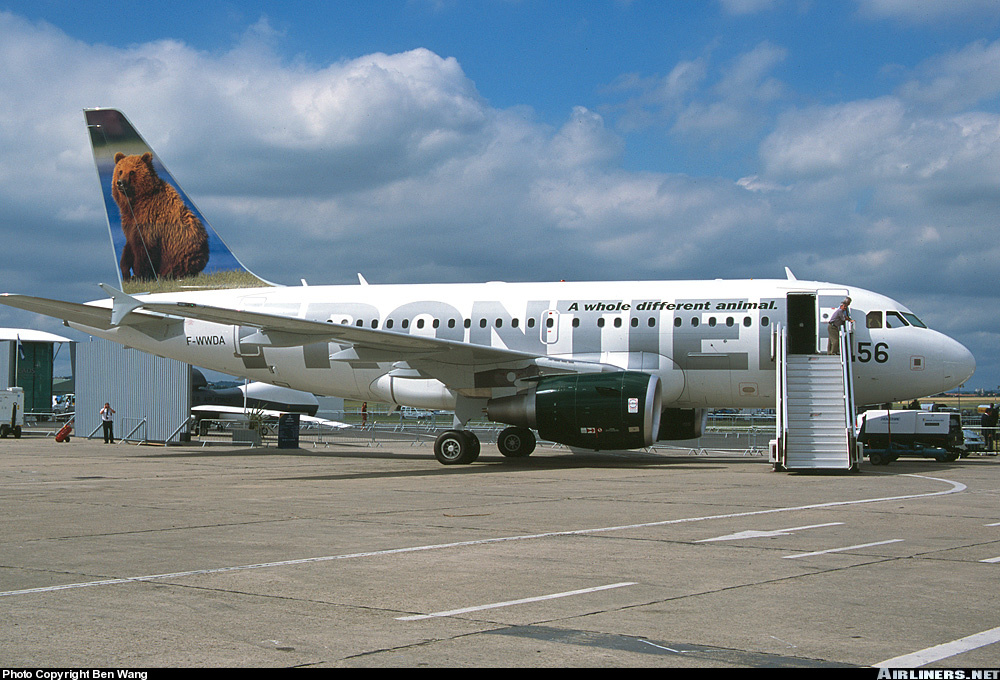

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


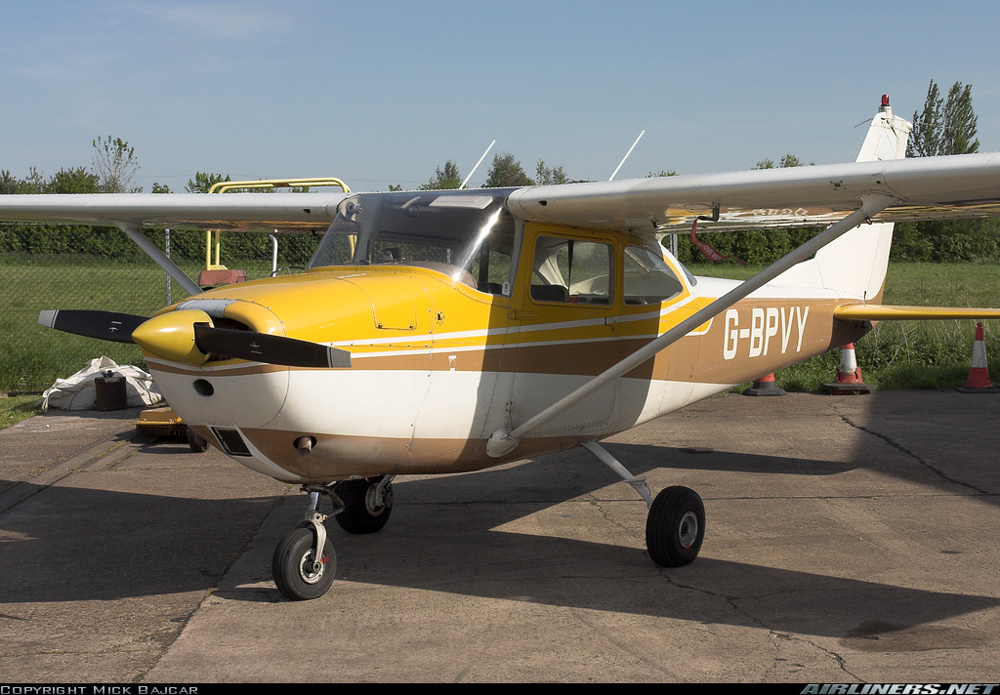

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


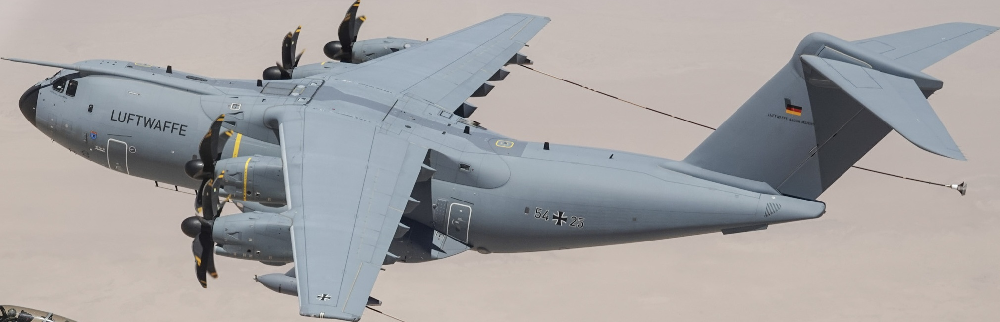

Question: 
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


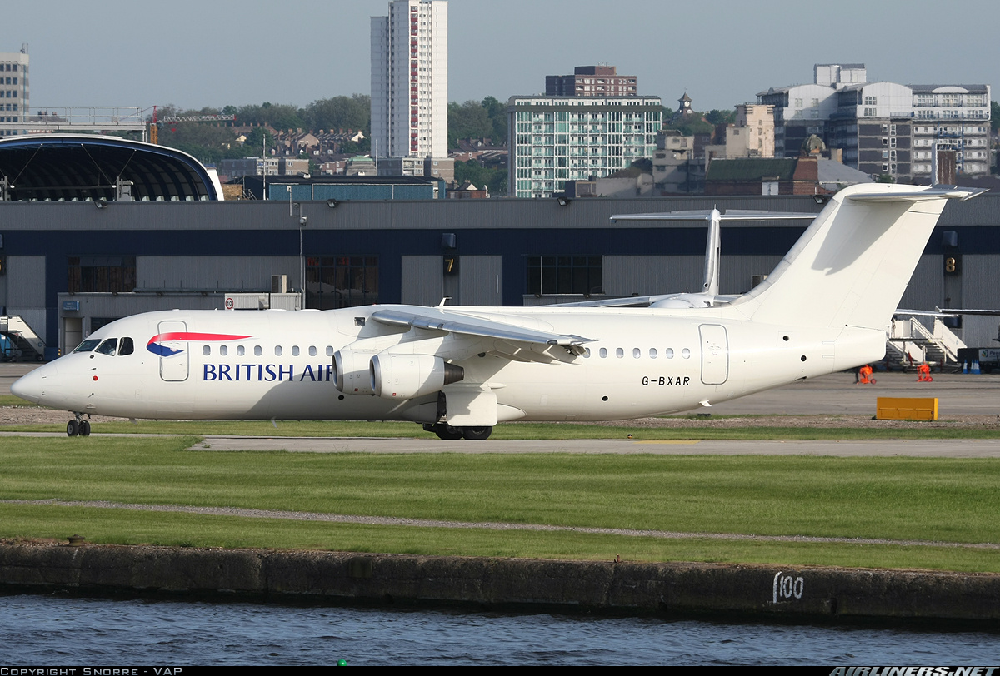

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


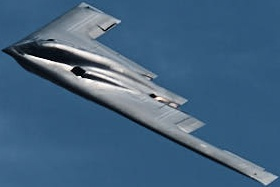

Question: 
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


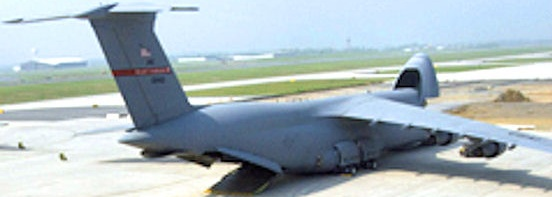

Question: 
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


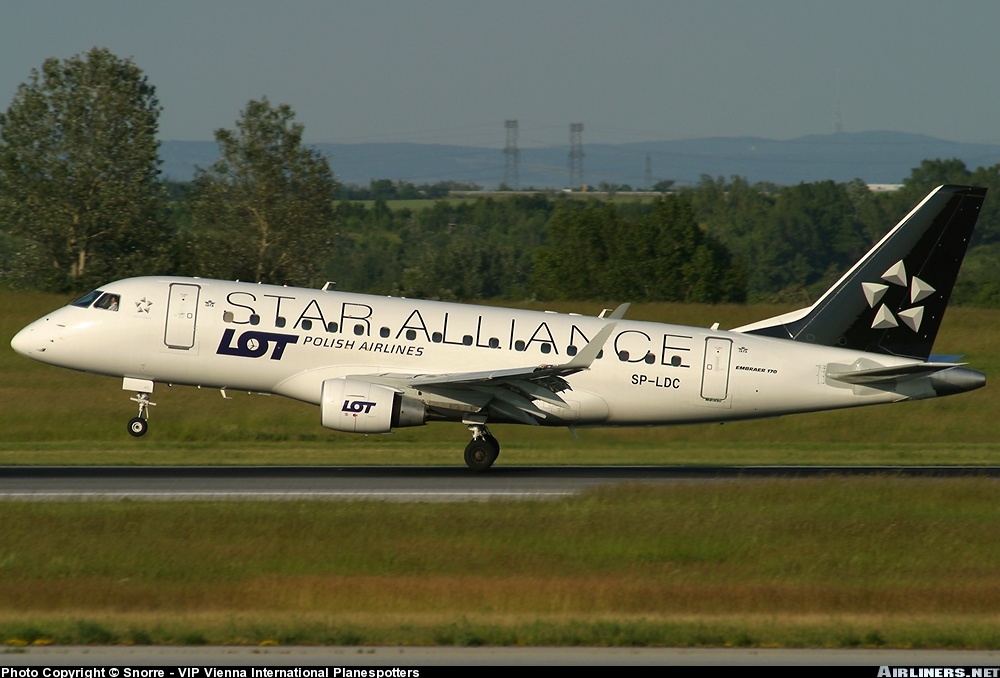

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 0 for civilian aircraft


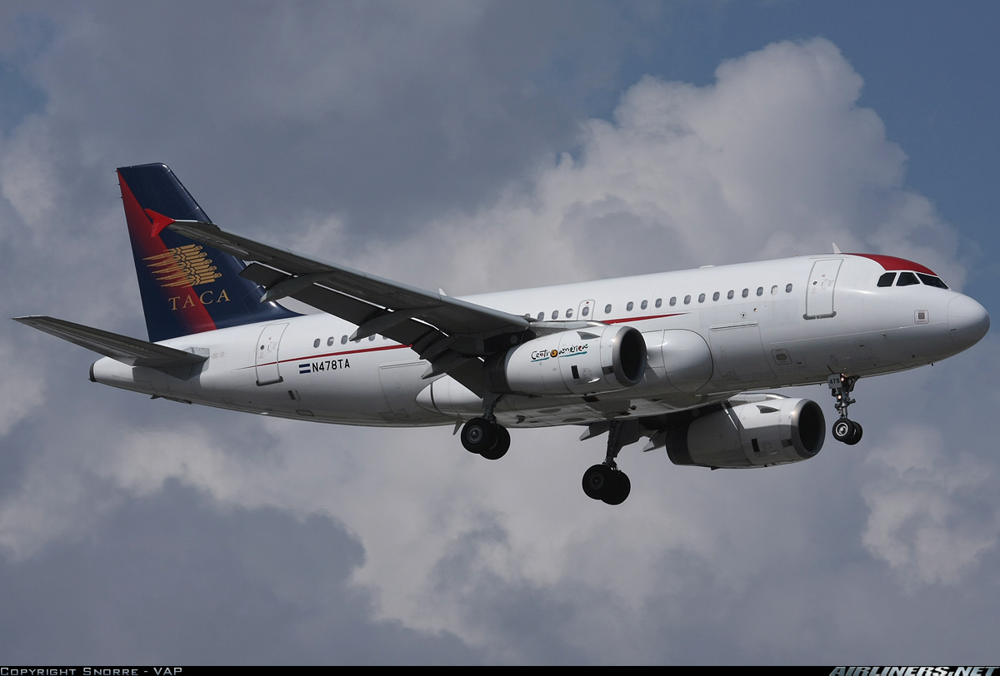

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1


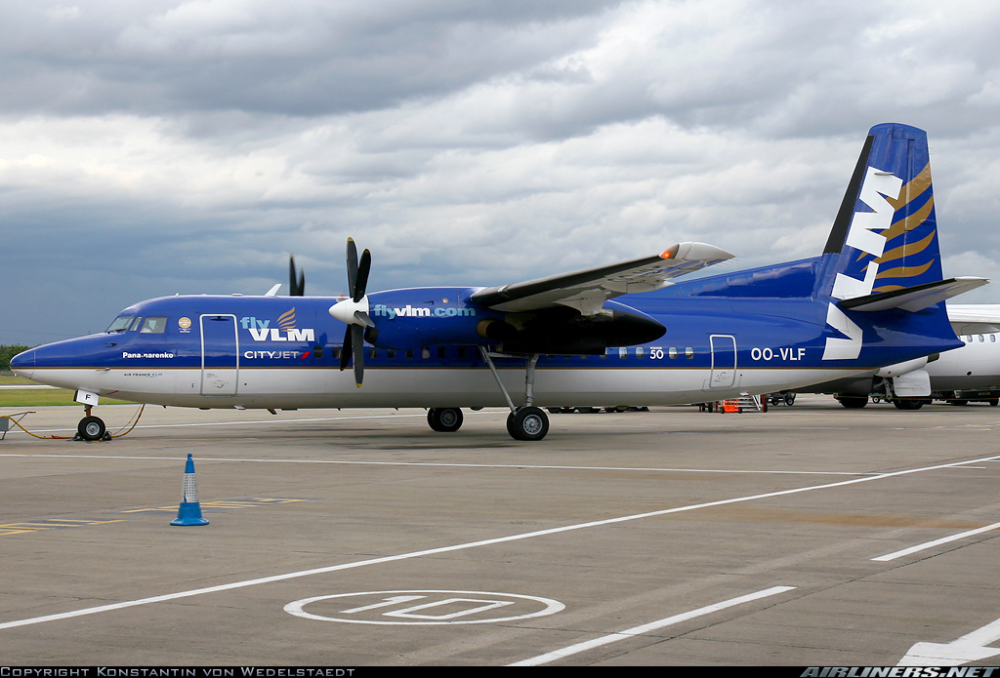

Question: 
Truth: 0
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 1
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 0


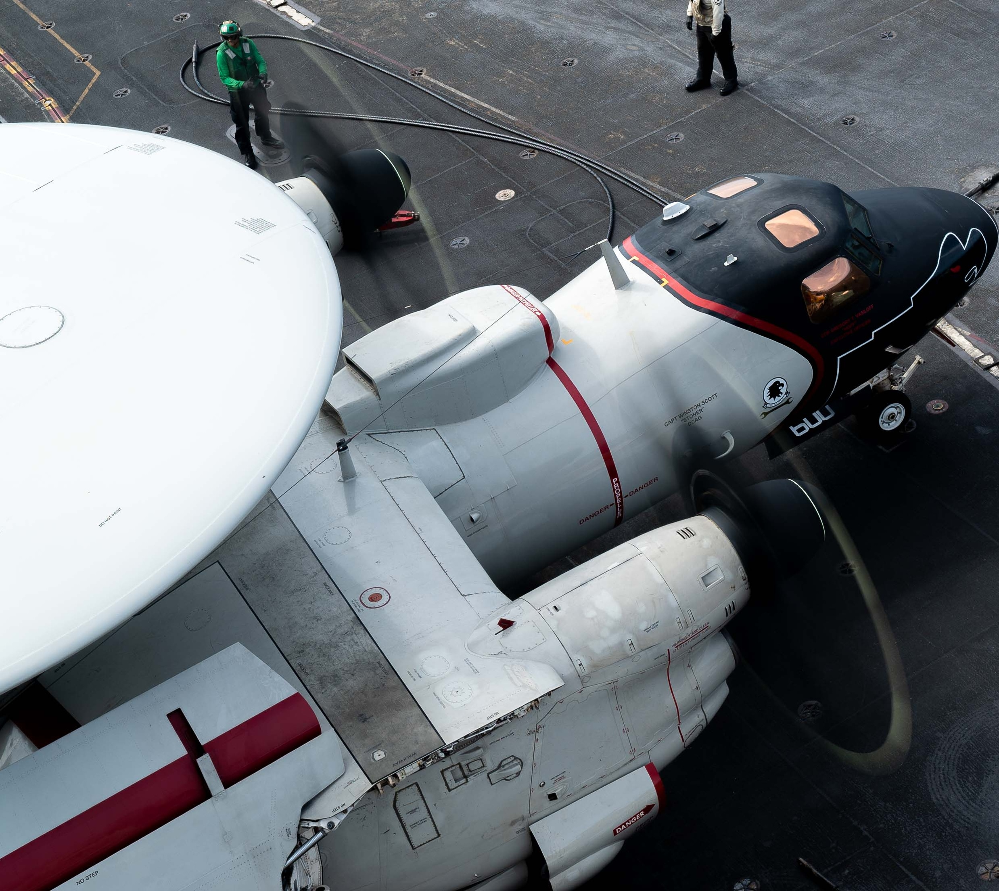

Question: 
Truth: 1
Predicted (Qwen/Qwen2-VL-2B-Instruct): 1
Predicted (llava-hf/llava-onevision-qwen2-0.5b-ov-hf): 0
Predicted (HuggingFaceTB/SmolVLM-256M-Instruct): 1
Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x680 at 0x78AC106C3F50>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x712 at 0x78AC1046FE10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2019x652 at 0x78AA609AFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A985CC3DD0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=280x187 at 0x78A985CCFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=552x197 at 0x78A98484FF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x678 at 0x78A97BCD7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x812 at 0x78A98484F910>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x695 at 0x78A97BC37F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2476x2207

In [22]:
from datasets import load_dataset

#----- hyperparameters -----

dataset_path = "Mr-Fox-h/Civil_or_Military"
dataset_split = "train"
sample_size = 10

system_prompt = "You are a military aircraft classification tool. Your ONLY function is to classify aircraft images as either civilian (0) or military (1)."\
"Return ONLY the single digit classification without ANY additional text, explanation, or formatting.\n"
global_user_prompt = "Classify this aircraft image. Output ONLY a single digit: 0 for civilian aircraft or 1 for military aircraft. Do not include any other text or explanation."

metric_type = "exact_match"

#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['image'] # get list of images
    question_data_list = [] # get list of questions (if necessary)
    answer_data_list = input_dataset['label'] # get list of answers
    answer_data_list = [str(i) for i in answer_data_list] # change to list of strings for comparison

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT

inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

show_individual(inputs, predictions)
show_results(inputs, predictions, evaluations)





In [4]:
from datasets import load_dataset

#----- hyperparameters -----

dataset_path = "Mr-Fox-h/Civil_or_Military"
dataset_split = "train"
sample_size = 50

system_prompt = "You are a military aircraft classification tool. Your ONLY function is to classify aircraft images as either civilian (0) or military (1)."\
"Return ONLY the single digit classification without ANY additional text, explanation, or formatting.\n"
global_user_prompt = "Classify this aircraft image. Output ONLY a single digit: 0 for civilian aircraft or 1 for military aircraft. Do not include any other text or explanation."

metric_type = "exact_match"

#----- data preparation function -----

# must return input images (PIL), question list, reference list
def prep_data(ds_path, ds_split, split_size=None):
    ds = load_dataset(ds_path, split=ds_split)

    if split_size is not None:
        shuffled_ds = ds.shuffle() # for random selection
        input_dataset = shuffled_ds.select(range(split_size))
    else:
        input_dataset = ds

    image_list = input_dataset['image'] # get list of images
    question_data_list = [] # get list of questions (if necessary)
    answer_data_list = input_dataset['label'] # get list of answers
    answer_data_list = [str(i) for i in answer_data_list] # change to list of strings for comparison

    return image_list, question_data_list, answer_data_list

#----- benchmarks -----
# DO NOT EDIT

inputs = prep_data(ds_path=dataset_path, ds_split=dataset_split, split_size=sample_size)
predictions, evaluations = run_benchmark(models=models, inputs=inputs, sys_user_prompts=[system_prompt, global_user_prompt], metric_type=metric_type)

show_individual(inputs, predictions)
show_results(inputs, evaluations)





Image list: [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x752 at 0x792A099D7F90>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x701 at 0x792B5A20F6D0>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3048x925 at 0x792A081D7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1599x1066 at 0x792A02BEFF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x679 at 0x792A01907F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x695 at 0x792A00E9FF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x678 at 0x792A0029B410>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=250x592 at 0x7929EF6E7F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x768 at 0x7929EEA53F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=193x67 at 0x7929EDCE3F10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x695 at 0x7929ED07BF10>, <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1200x838 a

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
You have video processor config saved in `preprocessor.json` file which is deprecated. Video processor configs should be saved in their own `video_preprocessor.json` file. You can rename the file or load and save the processor back which renames it automatically. Loading from `preprocessor.json` will be removed in v5.0.
Device set to use cuda:0
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


ValueError: height:21 and width:91 must be larger than factor:28